<a href="https://colab.research.google.com/github/olonok69/LLM_Notebooks/blob/main/image/operations/zoom/Zoom_Resize_Image.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



# Pixel Per inch

A pixel is one of the small dots or squares that make up an image on a computer screen. The more pixels there are, the more the image looks real or accurate. Any digital image is made up of pixels, and when someone talks about the resolution of a computer monitor or TV screen, they're referring to the number of pixels.


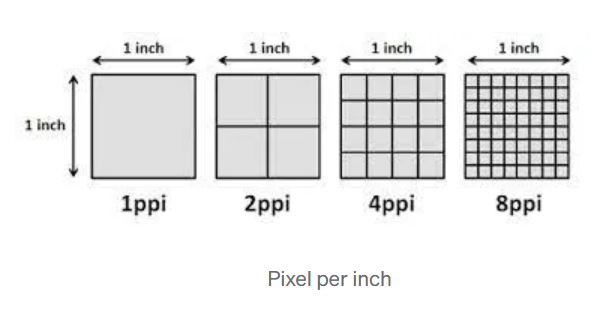


# Dots per Inch
What does DPI stand for? DPI stands for Dots per Inch, referring to the number of ink droplets a printer will produce per inch while printing an image. The more dots of ink per inch the picture has, the more detail you will see when printed.

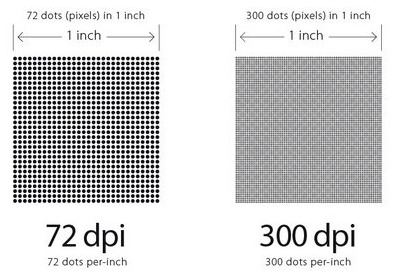



# Understanding DPI (Dots Per Inch)

Definition: DPI stands for "dots per inch." It's a measure of the resolution of a printed or displayed image.
Meaning: It indicates how many individual dots (pixels) are packed into one linear inch of an image.
Relevance:
Printing: In printing, DPI determines the sharpness and detail of a printed image. Higher DPI means more dots per inch, resulting in a sharper print.
Displays: On digital displays, DPI (or PPI, pixels per inch) indicates the pixel density of the screen. Higher DPI/PPI means a sharper and more detailed image on the screen.
Conversion: Inches to Pixels

To convert a physical measurement in inches to pixels, you need to know the DPI. The formula is:

Pixels = Inches * DPI

Let's say you have a printed image that is 5 inches wide, and it's printed at 300 DPI. How many pixels wide is the image?

```text
Given:
Width: 5 inches
DPI: 300
Calculation:
Pixels = 5 inches * 300 DPI
Pixels = 1500 pixels
Therefore, the image is 1500 pixels wide.
```

```python
def inches_to_pixels(inches, dpi):
    """
    Converts inches to pixels.

    Args:
        inches (float): Measurement in inches.
        dpi (int): Dots per inch.

    Returns:
        int: Measurement in pixels.
    """
    pixels = int(inches * dpi)
    return pixels

# Example usage:
width_inches = 5
height_inches = 3
dpi = 300

width_pixels = inches_to_pixels(width_inches, dpi)
height_pixels = inches_to_pixels(height_inches, dpi)

print(f"{width_inches} inches at {dpi} DPI = {width_pixels} pixels")
print(f"{height_inches} inches at {dpi} DPI = {height_pixels} pixels")

# Example for a notebook width of 10 inches and 100 dpi.
notebook_width_inches = 10
notebook_dpi = 100

notebook_width_pixels = inches_to_pixels(notebook_width_inches, notebook_dpi)

print(f"{notebook_width_inches} inches at {notebook_dpi} DPI = {notebook_width_pixels} pixels")

```

Interpolation methods are crucial in image processing, especially when resizing or transforming images. They determine how pixel values are calculated for the new image based on the original image's pixels. Here's a breakdown of common interpolation methods:

**1. Nearest-Neighbor Interpolation (cv2.INTER_NEAREST / Image.Resampling.NEAREST):**

* **How it works:** This is the simplest method. It assigns the value of the nearest pixel in the original image to the corresponding pixel in the resized image.
* **Pros:**
    * Very fast.
    * Preserves sharp edges.
* **Cons:**
    * Produces blocky or pixelated results, especially with significant scaling.
    * Poor quality for smooth gradients.
* **Use cases:** Suitable for images with sharp edges and minimal color variations, such as pixel art or when speed is critical.

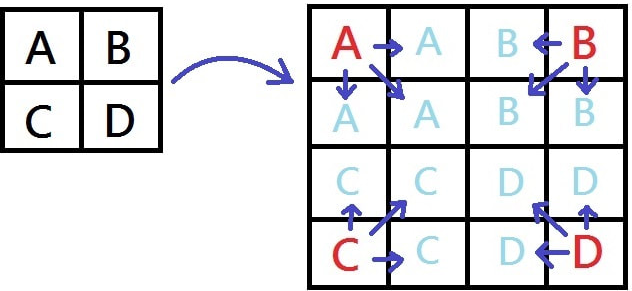



**2. Bilinear Interpolation (cv2.INTER_LINEAR / Image.Resampling.BILINEAR):**

* **How it works:** This method calculates the value of a pixel in the resized image by taking a weighted average of the four nearest pixels in the original image. The weights are determined by the distance of the new pixel from the original pixels.
* **Pros:**
    * Smoother results than nearest-neighbor.
    * Relatively fast.
* **Cons:**
    * Can blur fine details.
    * May introduce some artifacts.
* **Use cases:** A good balance between speed and quality, suitable for general-purpose image resizing.

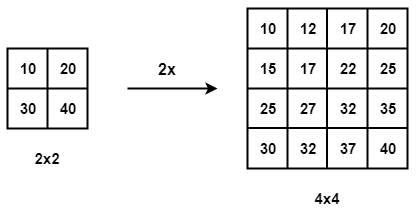


**3. Bicubic Interpolation (cv2.INTER_CUBIC):**

* **How it works:** Similar to bilinear interpolation, but it considers a 4x4 neighborhood of pixels around the new pixel's location. It uses a more complex cubic function to calculate the weighted average.
* **Pros:**
    * Produces smoother and more detailed results than bilinear interpolation.
    * Reduces artifacts.
* **Cons:**
    * Slower than bilinear and nearest-neighbor.
    * Can still blur very fine details.
* **Use cases:** Suitable for high-quality image resizing, especially when preserving fine details is important.

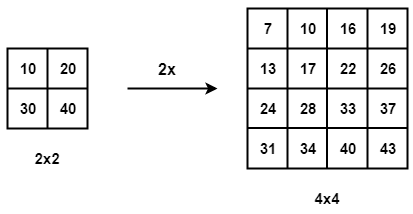



**4. Lanczos Interpolation (cv2.INTER_LANCZOS4 / Image.Resampling.LANCZOS):**

* **How it works:** This method uses a sinc function (modified by a Lanczos window) to calculate the pixel values. It considers a larger neighborhood of pixels than bicubic interpolation.
* **Pros:**
    * Provides the highest quality results, with sharp details and minimal artifacts.
    * Excellent for both upscaling and downscaling.
* **Cons:**
    * The slowest of the common interpolation methods.
    * Can sometimes introduce ringing artifacts (halos) around sharp edges.
* **Use cases:** Ideal for professional image editing and high-quality image resizing, where accuracy is paramount.

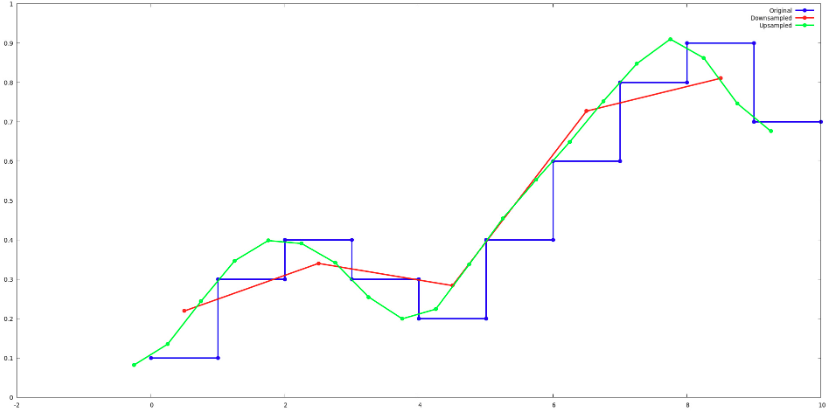



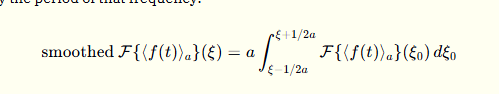

**Summary of Interpolation Methods:**

| Method | Speed | Quality | Use Cases |
| :--- | :--- | :--- | :--- |
| Nearest-Neighbor | Fastest | Lowest | Pixel art, speed-critical applications |
| Bilinear | Fast | Medium | General-purpose resizing |
| Bicubic | Medium | High | High-quality resizing, detail preservation |
| Lanczos | Slowest | Highest | Professional image editing, critical detail preservation |

When choosing an interpolation method, consider the trade-off between speed and quality. If speed is critical, use nearest-neighbor or bilinear interpolation. If quality is paramount, use bicubic or Lanczos interpolation. Lanczos typically gives the best results, but it is also the slowest.


# links
https://mazzo.li/posts/lanczos.html

In [117]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [118]:
! pip install pymupdf -q

In [120]:
from PIL import Image

In [121]:
image1 = '/content/drive/MyDrive/data/images/images/check.tif'
image2= "/content/drive/MyDrive/data/images/images/zermatt.jpg"

In [163]:
img = Image.open(image2)
width, height = img.size
width, height

(1500, 1000)

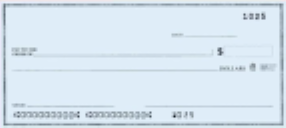

In [125]:
img

In [150]:
from PIL import Image

def zoom_image(image_path, zoom_factor, output_path):
    """
    Zooms an image using Pillow (PIL).

    Args:
        image_path (str): Path to the input image.
        zoom_factor (float): The zoom factor (e.g., 2.0 for 2x zoom).
        output_path (str): Path to save the zoomed image.
    """
    cropped_img = None
    try:
        img = Image.open(image_path)
        width, height = img.size

        new_width = int(width * zoom_factor)
        new_height = int(height * zoom_factor)

        # Calculate the cropping box to zoom into the center
        left = (new_width - width) // 2
        top = (new_height - height) // 2
        right = left + width
        bottom = top + height

        # Resize the image to the zoomed size
        zoomed_img = img.resize((new_width, new_height), Image.Resampling.NEAREST)

        # Crop the center part to the original size
        cropped_img = zoomed_img.crop((left, top, right, bottom))

        # cropped_img.save(output_path)
        # print(f"Image zoomed and saved to {output_path}")


    except FileNotFoundError:
        print(f"Error: Image not found at {image_path}")

    except Exception as e:
        print(f"An error occurred: {e}")
    finally:
        return cropped_img

# Example usage:

zoom_factor = 2.0  # Adjust the zoom factor as needed
image2_output_path = "zoomed_output.jpg"

img_zoomed = zoom_image(image2, zoom_factor, image2_output_path)

In [151]:
img_zoomed.size, img.size

((1500, 1000), (286, 128))

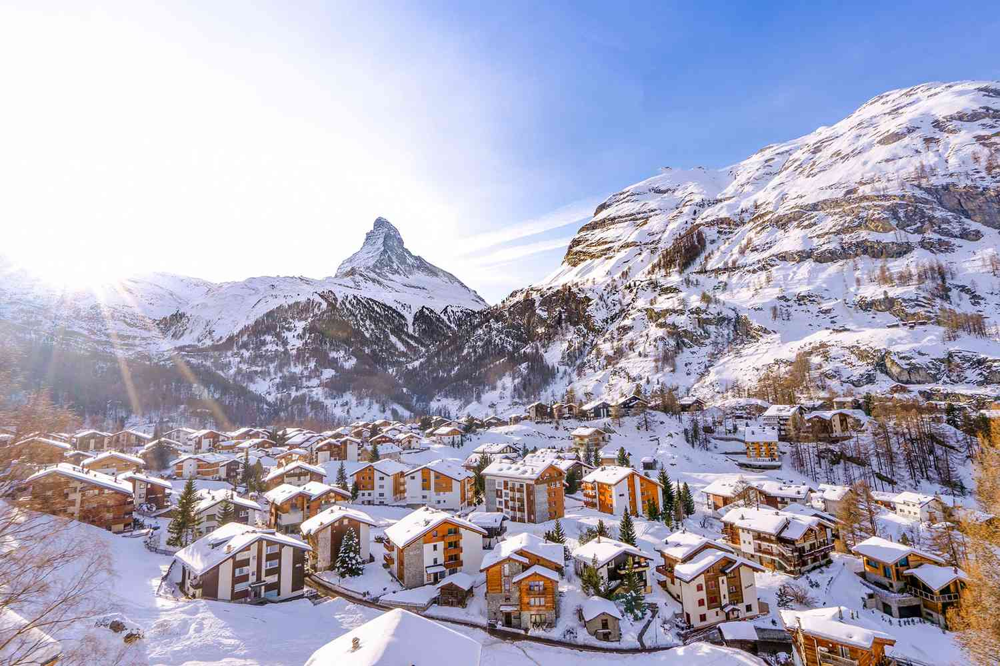

In [164]:
img

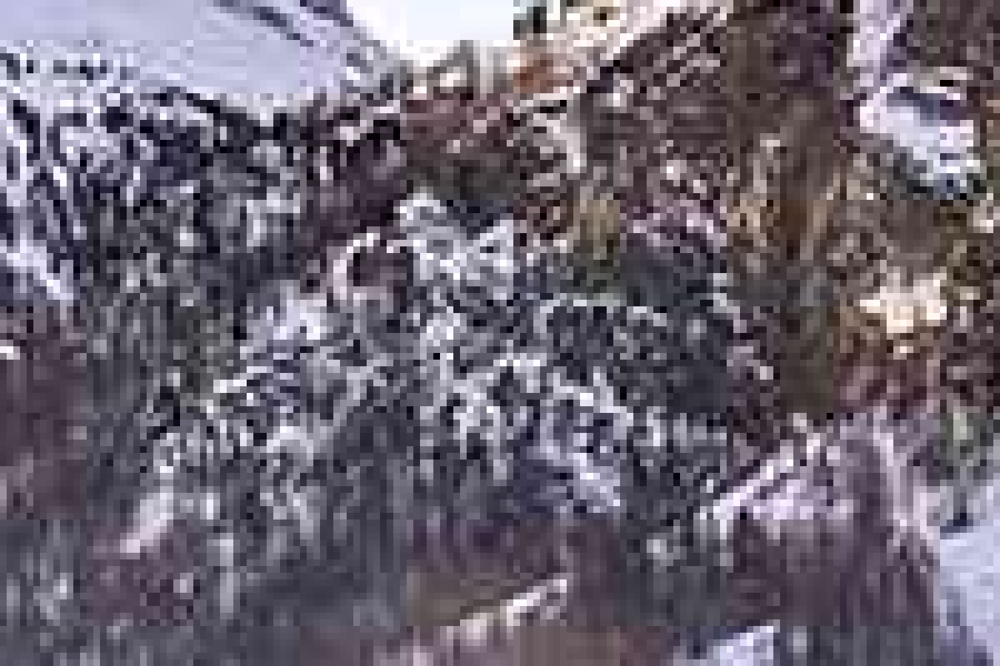

In [140]:
img_zoomed

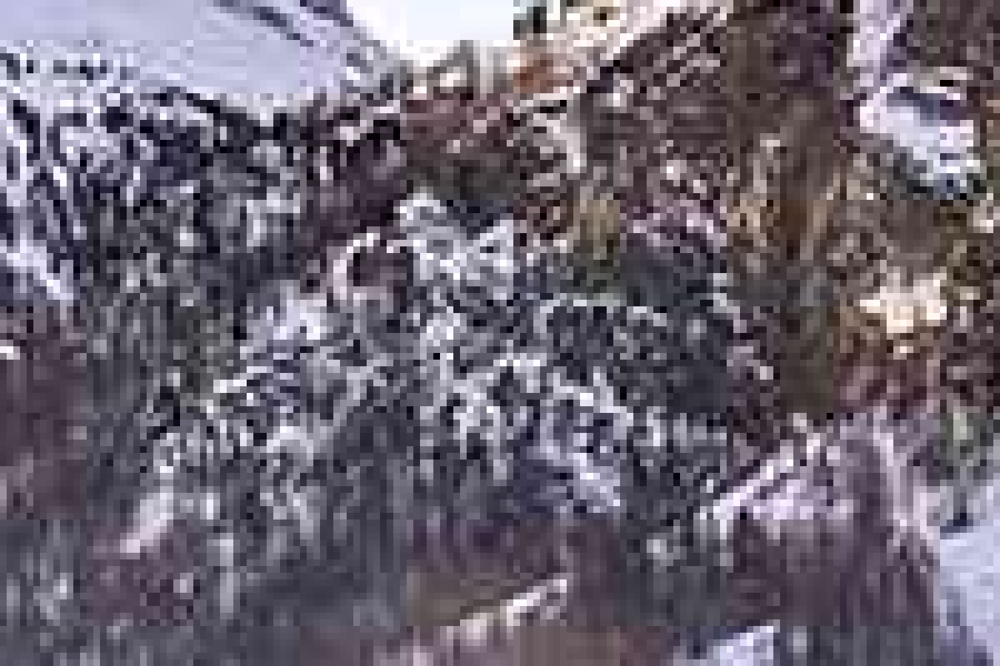

In [141]:
img_zoomed # 2/3

In [142]:
import cv2
import numpy as np

def zoom_image_opencv(image_path, zoom_factor, output_path):
    """
    Zooms an image using OpenCV.

    Args:
        image_path (str): Path to the input image.
        zoom_factor (float): The zoom factor (e.g., 2.0 for 2x zoom).
        output_path (str): Path to save the zoomed image.
    """
    cropped_img = None
    try:
        img = cv2.imread(image_path)
        if img is None:
            raise FileNotFoundError(f"Image not found at {image_path}")

        height, width = img.shape[:2]

        new_width = int(width * zoom_factor)
        new_height = int(height * zoom_factor)

        # Resize the image using INTER_LANCZOS4 for high-quality zooming
        zoomed_img = cv2.resize(img, (new_width, new_height), interpolation=cv2.INTER_LANCZOS4)

        # Calculate the cropping box to zoom into the center
        left = (new_width - width) // 2
        top = (new_height - height) // 2
        right = left + width
        bottom = top + height

        # Crop the center part to the original size
        cropped_img = zoomed_img[top:bottom, left:right]

        # cv2.imwrite(output_path, cropped_img)
        # print(f"Image zoomed and saved to {output_path}")

    except FileNotFoundError as e:
        print(f"Error: {e}")
    except Exception as e:
        print(f"An error occurred: {e}")
    finally:
      return cropped_img

In [153]:
img_zoomed_cv = zoom_image(image1, zoom_factor, image2_output_path)

In [154]:
img_zoomed_cv.size, img.size

((286, 128), (286, 128))

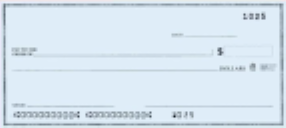

In [155]:
img

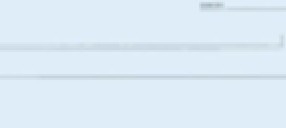

In [156]:
img_zoomed_cv

In [158]:
import sys, pymupdf  # import the bindings
fname = "/content/drive/MyDrive/data/Contribution Form Juan Huertas 26012025.pdf"  # path to the PDF file
doc = pymupdf.open(fname)  # open document
for page in doc:  # iterate through the pages
    pix = page.get_pixmap()  # render page to an image
     # Zoom in the image
    zoom_x = 2.0  # horizontal zoom
    zoom_y = 2.0  # vertical zoom
    mat = pymupdf.Matrix(zoom_x, zoom_y)  # zoom factor 2 in each dimension
    pix = page.get_pixmap(matrix=mat)
    im = Image.frombytes("RGB", (pix.width, pix.height), pix.samples)
    im = im.convert("RGB")
    im.save("/content/drive/MyDrive/data/page-%i.png" % page.number)  # store image as a PNG
    print(f"image size {im.size}")

image size (1222, 1682)
image size (1222, 1682)
image size (1222, 1682)
image size (1222, 1682)
image size (1222, 1682)
image size (1222, 1682)
image size (1222, 1682)
image size (1222, 1682)


In [159]:
from PIL import Image

def zoom_image_no_crop(image_path, zoom_factor, output_path, resample_method=Image.Resampling.LANCZOS):
    """
    Zooms an image using Pillow without cropping, increasing the image size.

    Args:
        image_path (str): Path to the input image.
        zoom_factor (float): The zoom factor (e.g., 2.0 for 2x zoom).
        output_path (str): Path to save the zoomed image.
        resample_method: The resampling method (e.g., Image.Resampling.LANCZOS, Image.Resampling.BILINEAR, Image.Resampling.NEAREST).
    """
    zoomed_img = None
    try:

        img = Image.open(image_path)
        width, height = img.size

        new_width = int(width * zoom_factor)
        new_height = int(height * zoom_factor)

        zoomed_img = img.resize((new_width, new_height), resample_method)

        # zoomed_img.save(output_path)
        # print(f"Image zoomed and saved to {output_path}, new size: {zoomed_img.size}")

    except FileNotFoundError:
        print(f"Error: Image not found at {image_path}")
    except Exception as e:
        print(f"An error occurred: {e}")
    finally:
      return zoomed_img



img_nearest = zoom_image_no_crop(image2, zoom_factor, image2_output_path, Image.Resampling.NEAREST)
img_bilinear = zoom_image_no_crop(image2, zoom_factor, image2_output_path, Image.Resampling.BILINEAR)
img_lanczos = zoom_image_no_crop(image2, zoom_factor, image2_output_path, Image.Resampling.LANCZOS)
img_bicubic = zoom_image_no_crop(image2, zoom_factor, image2_output_path, Image.Resampling.BICUBIC)

In [160]:
img_nearest.size, img_bilinear.size, img_lanczos.size, img_bicubic.size, img.size

((3000, 2000), (3000, 2000), (3000, 2000), (3000, 2000), (286, 128))

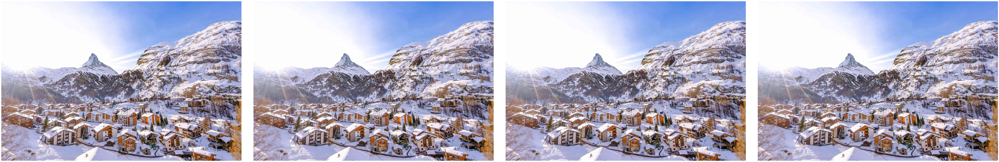

In [161]:
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

def plot_pillow_images_in_row(images, notebook_width=100):
    """
    Plots a list of Pillow Image objects in a single row, resizing them to fit the notebook width.

    Args:
        images (list): List of Pillow Image objects.
        notebook_width (int): Width of the notebook in inches (default: 10).
    """
    if not images:
        print("Error: Empty list of images provided.")
        return

    # Assuming a typical notebook DPI of 100 (adjust as needed)
    notebook_width_pixels = notebook_width * 100

    # Calculate the total width of the original images
    total_original_width = sum(img.width for img in images)

    # Calculate the scaling factor to fit the notebook width
    scaling_factor = notebook_width_pixels / total_original_width

    # Resize the images
    resized_images = [img.resize((int(img.width * scaling_factor), int(img.height * scaling_factor)), Image.Resampling.LANCZOS) for img in images]

    # Convert to NumPy arrays for Matplotlib
    np_images = [np.array(img) for img in resized_images]

    # Plot the images in a single row
    fig, axes = plt.subplots(1, len(images), figsize=(notebook_width, np_images[0].shape[0] / 100))
    fig.subplots_adjust(wspace=0.05)

    if len(images) == 1:
      axes = [axes] #make iterable if there is only one image.

    for i, ax in enumerate(axes):
        ax.imshow(np_images[i])
        ax.axis('off')

    plt.show()


images = [img_nearest,   , img_lanczos, img_bicubic]


plot_pillow_images_in_row(images)



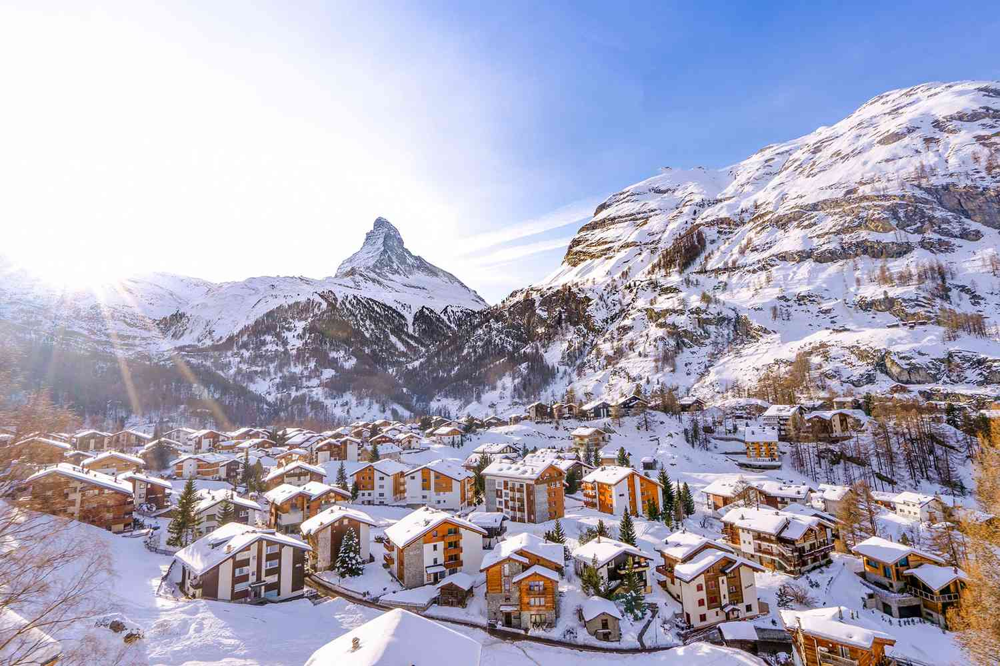

In [166]:
img

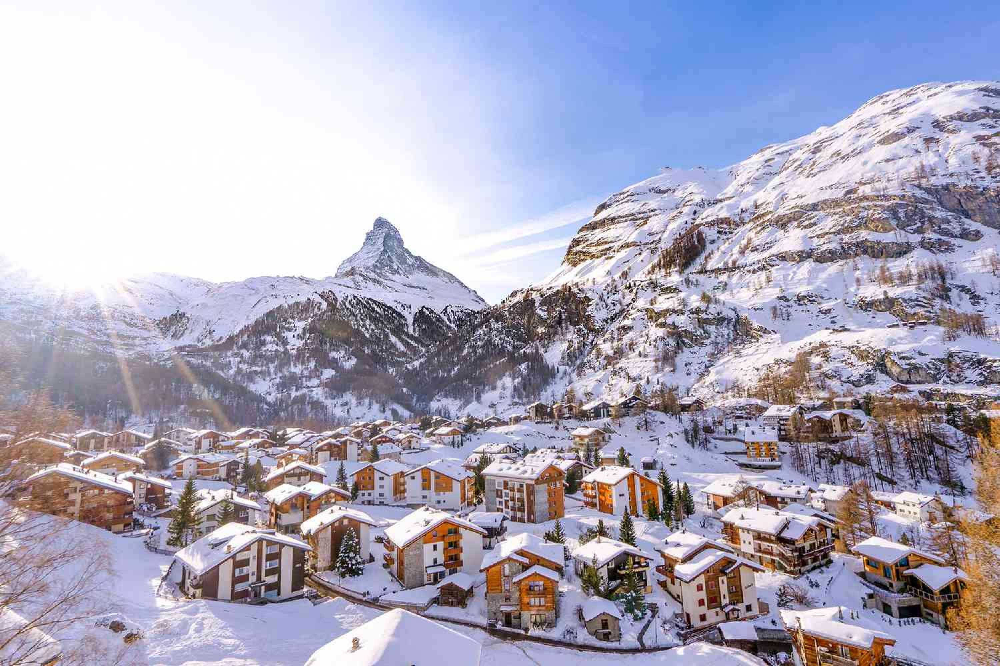

In [167]:
img_nearest